# CS 7324-400B: Lab Two - Exploring Image Data
#### Fall 2023
#### Author: Davis Vercher (49377022)

##### References & Citations
- **Download Link:**
    - https://lila.science/datasets/missouricameratraps
- **Sources:**
    - Zhang, Z., He, Z., Cao, G., & Cao, W. (2016). Animal detection from highly cluttered natural scenes using spatiotemporal object region proposals and patch verification. IEEE Transactions on Multimedia, 18(10), 2079-2092. (bibtex)

## 1. Business Understanding

### 1a. Bottom Line Up Front:
I am using wildlife trail camera (also known as "camera traps") images taken from one specific property in Missouri of white-tailed deer and wild hogs to create a binary image classification model that can accurately predict if any particular trail camera image contains either a deer or a hog. The extent of this notebook does not cover the actual model creation, and only demonstrates the data preparation and reduction steps ahead of the actual model training/testing.

### 1b. Background & Key Points
- **Original Purpose:** This dataset was originally collected in 2011 and 2012 and used to research image classification of specific animal species in "highly cluttered" natural scenes. Each image taken was triggered by a motion sensor on a trail camera set up in a forrested nature area and usually contains only one animal or a handful of animals of the same species moving together. The job of creating an image classification model of the specific animal is made more difficult by the fact that images are taken both in the day and at night (two different RGB color patterns for each species), a majority of each image is foliage and not the animal, and the overall image quality is slightly grainy and blurred (especially if the animal is running).

- **My Purpose:** As a hunter, having a trail camera that can accurately identify the animal in the image it takes whenever the motion sensor is tripped would be enormously helpful. In theory, this classification model (that can discern between trail camera images of deer and hogs) could be integrated into a trail camera system and only send me alerts when a deer triggers the camera in my hunting area (in my area, hogs trigger these cameras far more often than deer)... allowing me to only focus on the information I care about (images of deer) and not that which I don't (images of hogs). A real working model like this could be used as a competitive advantage for any existing trail camera manufacturer, would make the work of wildlife researchers more efficient, and would provide hunters like me with a powerful scouting tool.

- **Dataset Information:** The full dataset (linked above) contains over 25,000 images belonging to 20 classes (20 different animal species). Each species is divided into its own directory, and each directory contains specific image captures of that animal. For this notebook, I stripped 18 of the 20 classes and have kept the directories for White-Tailed Deer and Wild Hogs only. Both of these classes originally contained ~1,600 images, but I have kept 550 of each class for the purpose of this notebook. Each image is of the shape 2048 pixels x 1536 pixels x 3 color channels (RGB).

- **Measure of Success:** Because I want my end user to be able to filter out all hog images from their trail camera (or all deer images if they care to only see hogs), I need my model to have an accuracy at or above 95% to be considered successful. It would be very frustrating for the end user to be missing the images of the animal species they care to hunt (i.e., they receive alerts that their camera was triggered by a deer only to open their trail camera app and see images of hogs).

- **Complications & Further Information:** Both classes contain images of their respective animals both in the day and at night, and in all four seasons of foliage in Missouri. Additionally, there are images within each class from the original dataset that are labeled as if they contain an animal but in fact are just empty forrest. These complications in reality create multiple versions of each class (e.g., night time deer, day time deer, winter deer, summer deer, etc.) and add noise to the data (false positive "blank" images). Because of the day/night problem, I will be converting these RGB images into grayscale. These complications also make this dataset not easy to use for a simple binary image classifier. However, this is a use case I genuinely care about, and have not been able to solve on my own. I am hoping that my exploration of this use case again throughout this course will help me learn how to make a working trail camera species classifier. As a hunter, this use case is what got me into coding and AI almost four years ago.

### 1c. Example Images
Figure 1 and Figure 2 depict actual images from the original dataset.

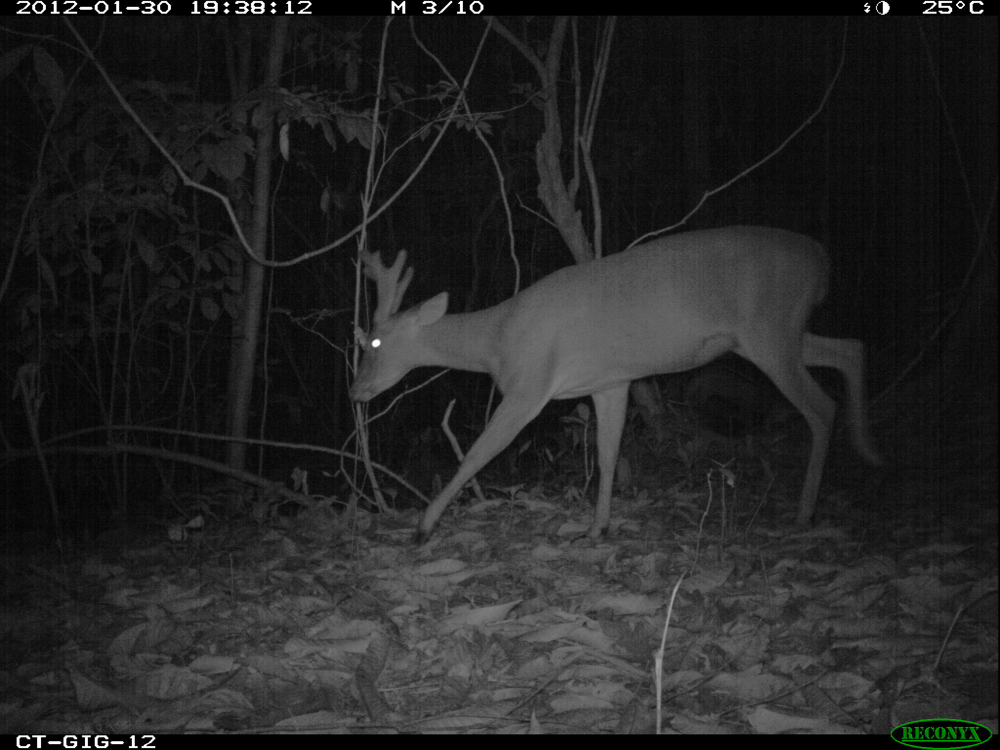

***Figure 1***

White-Tailed Deer from the Missouri Camera Trap dataset

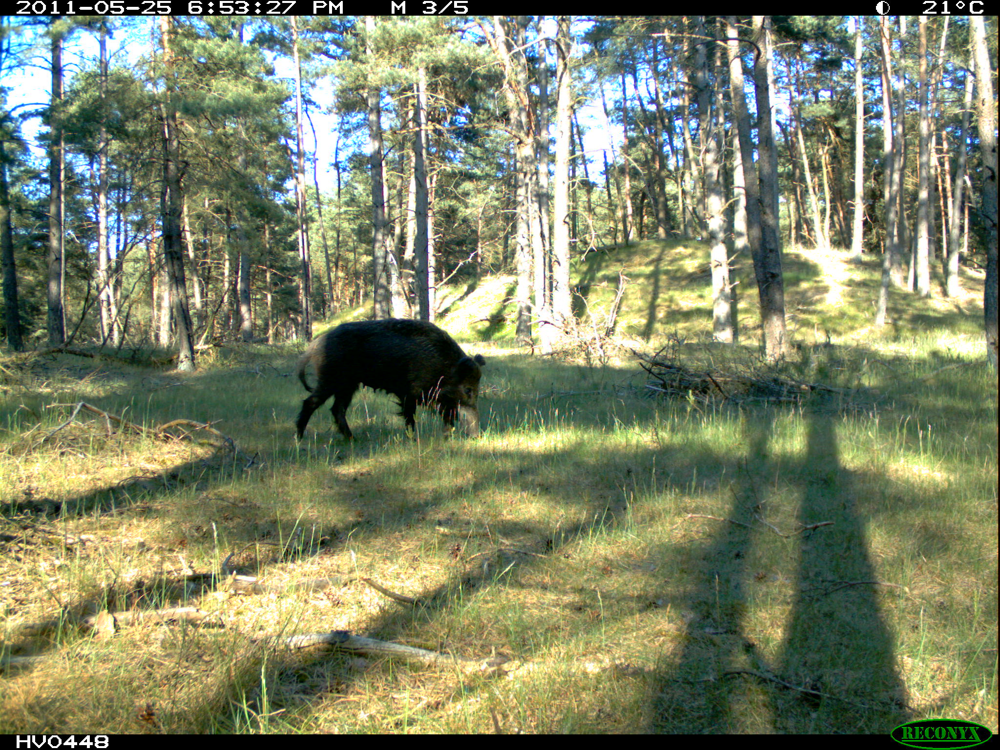

***Figure 2***

Wild Hog from the Missouri Camera Trap dataset

## 2. Data Preparation

### 2a. Reading in the images and resizing

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from pathlib import Path
from skimage import color

In [5]:
ds_path = Path('C:/Users/Personal/Desktop/SMU/02Fall2023/cs7324_Machine_Learning_in_Python/Lab 2/lab2_animals_dataset')

In [13]:
data = []
labels = []

# Iterating over both the deer and hog directories withing 'lab2_animals_dataset'
for class_dir in ds_path.iterdir():
        for img_path in class_dir.iterdir():
            img = cv2.imread(str(img_path))
            
            # Resizing the pixel size of each image for computational ease (from 2048x1536 to 120x120)
            # Note: the images are all three color channel RGB images, and that informaiton is being retained
            img = cv2.resize(img, (120, 120))
            
            # Converting to greyscale from RGB to mitigate difference between day and night time images
            img = color.rgb2gray(img)
            
            # Storing the image and its label
            data.append(img)
            labels.append(str(class_dir.name))

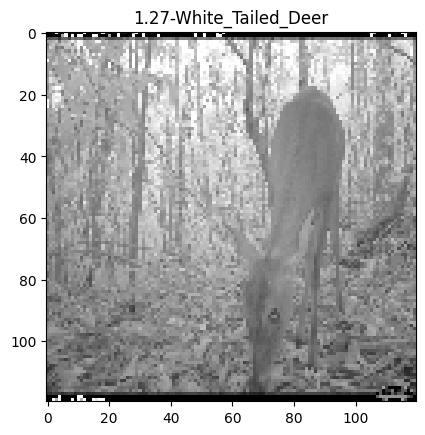

In [24]:
# Visualizing one of the deer images (first half of 'data[]')
i = 40
img = data[i]
label = labels[i]

plt.imshow(img, cmap='gray')
plt.title(label)
plt.show()

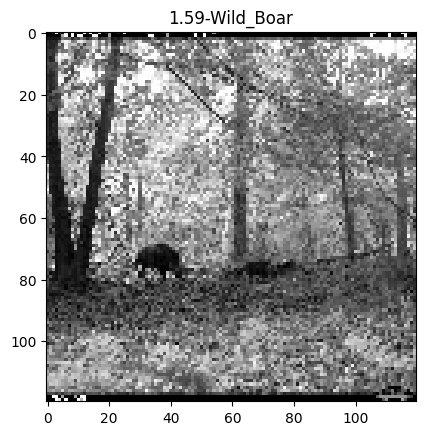

In [26]:
# Visualizing one of the hog images (second half of 'data[]')
i = 1075
img = data[i]
label = labels[i]

plt.imshow(img, cmap='gray')
plt.title(label)
plt.show()

### 2b. Image linearization

In [27]:
linear_data = [img.flatten() for img in data]
np_data = np.array(linear_data)

In [28]:
print(len(np_data)); print(len(np_data[0]))

1100
14400


I can see that I have all 1,100 images (550 of each of the two classes) and 14,400 features of each. The features are broken down as 14,400 pixel values (120 pixels wide x 120 pixels tall x 1 color channel).

### 2c. Visualizing some images from the dataframe

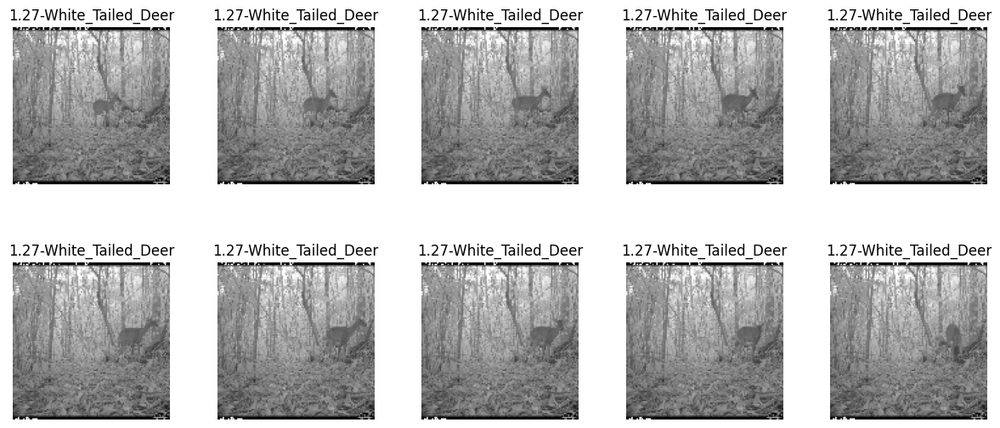

In [31]:
# Visualizing the first ten images from np_data
fig, axes = plt.subplots(2, 5, figsize=(15,6))
axes = axes.ravel()

for i in np.arange(0, 10):
    img_data = np_data[i].reshape(120, 120, 1)
    axes[i].imshow(img_data, cmap='gray')
    axes[i].set_title(labels[i], fontsize=12)
    plt.subplots_adjust(hspace=0.5)
    axes[i].axis('off')

plt.show()

## 3. Data Reduction

### 3a. Standard PCA

In [32]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [33]:
scaler = StandardScaler()
scaled_data = scaler.fit_transform(np_data)

In [34]:
n_components = 50
pca = PCA(n_components=n_components)
principal_componenents = pca.fit_transform(scaled_data)

In [35]:
explained_variance_ratio = pca.explained_variance_ratio_
print(explained_variance_ratio)
print(sum(explained_variance_ratio))

[5.64595850e-01 1.20790372e-01 5.77101950e-02 4.01978040e-02
 2.74735734e-02 1.71037280e-02 1.37934760e-02 1.23111712e-02
 1.00720012e-02 9.23737304e-03 8.72894629e-03 8.24921608e-03
 6.91704236e-03 5.64189626e-03 5.46101776e-03 4.80444262e-03
 4.48353905e-03 4.41388712e-03 4.23756472e-03 3.64556320e-03
 3.39874907e-03 3.21930217e-03 3.09914987e-03 2.80576391e-03
 2.44903178e-03 2.41763589e-03 2.25794625e-03 2.02567805e-03
 1.87372201e-03 1.83877729e-03 1.65042497e-03 1.38656925e-03
 1.34385562e-03 1.11314432e-03 1.10511741e-03 1.05763601e-03
 9.37119808e-04 9.10704376e-04 8.30146681e-04 7.64381490e-04
 7.32994910e-04 7.08495289e-04 6.89386442e-04 6.03095662e-04
 5.91067547e-04 5.75702064e-04 5.60468737e-04 5.37238469e-04
 5.24342627e-04 4.96139958e-04]
0.9723724481722829


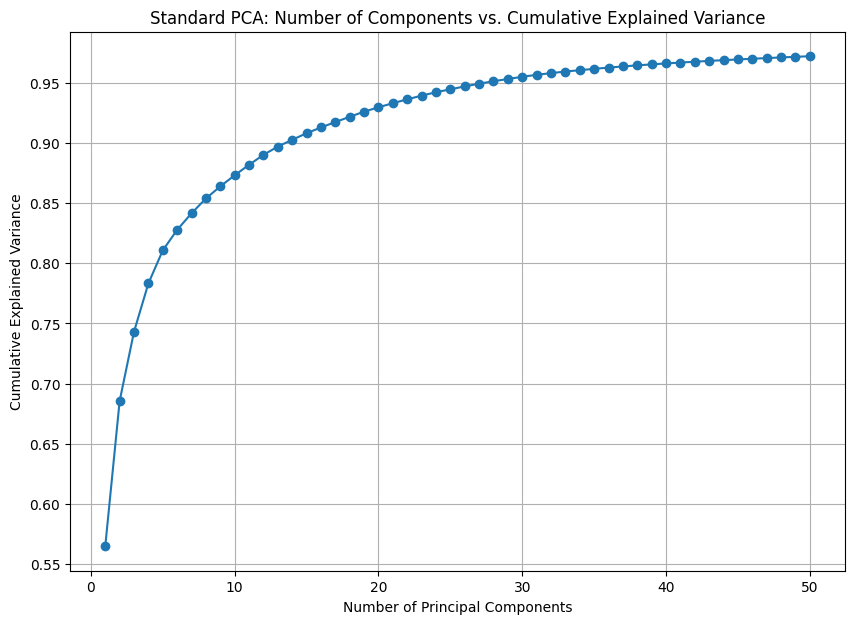

In [36]:
plt.figure(figsize=(10, 7))
plt.plot(range(1, n_components + 1), np.cumsum(explained_variance_ratio), marker='o')
plt.title('Standard PCA: Number of Components vs. Cumulative Explained Variance')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
plt.show()

In [38]:
cumulative_variance = np.cumsum(pca.explained_variance_ratio_)
num_components_95 = np.argmax(cumulative_variance >= 0.95) + 1
print(f"The number of components to have >= 95% variance is {num_components_95}")

The number of components to have >= 95% variance is 28


I see here that from 14,400 components in the original dataset for each row (image), I have reduced down to just 28 (with a threshold for variance set to 95%). This means that I will keep 95% of the information about the data that can help me create the end-state classification model and reduce the computational load required significantly. 

However, I will be losing 5% of the information present in my original dataset, which is a trade-off. Reducing all the way down to 28 components may result in a failure for my model to find the nuanced difference between deer and hogs in the same environmental setting (trust me, these animals look A LOT a like at night and obscured by trees/foliage).

### 3a. Random PCA

In [39]:
n_components = 50
random_pca = PCA(n_components=n_components)
random_principal_componenents = random_pca.fit_transform(scaled_data)

In [40]:
random_explained_variance_ratio = random_pca.explained_variance_ratio_
print(random_explained_variance_ratio)
print(sum(random_explained_variance_ratio))

[5.64595850e-01 1.20790372e-01 5.77101950e-02 4.01978040e-02
 2.74735734e-02 1.71037280e-02 1.37934760e-02 1.23111712e-02
 1.00720012e-02 9.23737304e-03 8.72894629e-03 8.24921608e-03
 6.91704236e-03 5.64189626e-03 5.46101776e-03 4.80444262e-03
 4.48353905e-03 4.41388712e-03 4.23756472e-03 3.64556320e-03
 3.39874907e-03 3.21930217e-03 3.09914987e-03 2.80576391e-03
 2.44903178e-03 2.41763589e-03 2.25794625e-03 2.02567805e-03
 1.87372201e-03 1.83877729e-03 1.65042497e-03 1.38656925e-03
 1.34385562e-03 1.11314432e-03 1.10511742e-03 1.05763601e-03
 9.37119816e-04 9.10704348e-04 8.30147343e-04 7.64381550e-04
 7.32993790e-04 7.08496196e-04 6.89384825e-04 6.03102711e-04
 5.91109546e-04 5.75707381e-04 5.60378175e-04 5.37154036e-04
 5.24357036e-04 4.97087371e-04]
0.9723732882481106


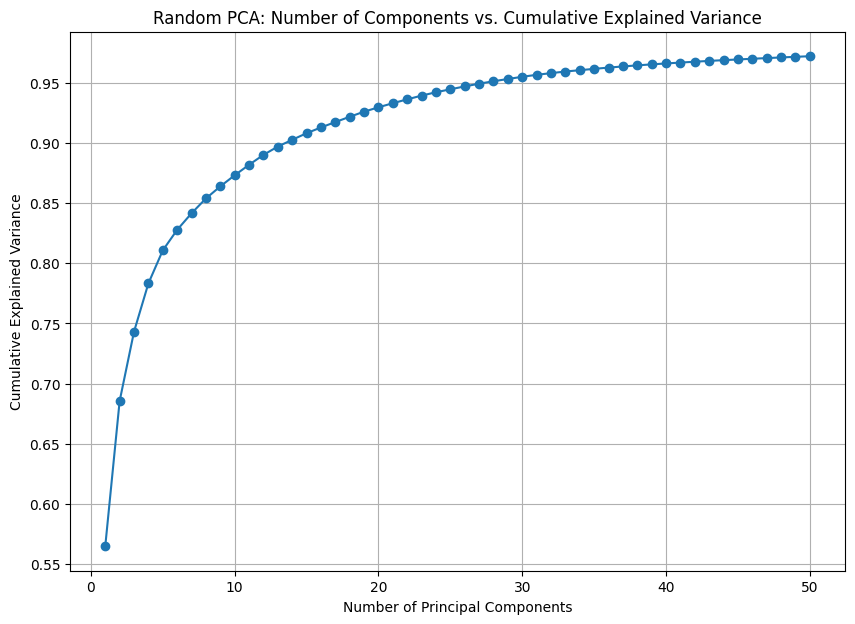

In [41]:
plt.figure(figsize=(10, 7))
plt.plot(range(1, n_components + 1), np.cumsum(random_explained_variance_ratio), marker='o')
plt.title('Random PCA: Number of Components vs. Cumulative Explained Variance')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
plt.show()

In [42]:
random_cumulative_variance = np.cumsum(random_pca.explained_variance_ratio_)
random_num_components_95 = np.argmax(random_cumulative_variance >= 0.95) + 1
print(f"The number of components to have >= 95% variance is {random_num_components_95}")

The number of components to have >= 95% variance is 28


In [44]:
print(pca.explained_variance_ratio_)

[5.64595850e-01 1.20790372e-01 5.77101950e-02 4.01978040e-02
 2.74735734e-02 1.71037280e-02 1.37934760e-02 1.23111712e-02
 1.00720012e-02 9.23737304e-03 8.72894629e-03 8.24921608e-03
 6.91704236e-03 5.64189626e-03 5.46101776e-03 4.80444262e-03
 4.48353905e-03 4.41388712e-03 4.23756472e-03 3.64556320e-03
 3.39874907e-03 3.21930217e-03 3.09914987e-03 2.80576391e-03
 2.44903178e-03 2.41763589e-03 2.25794625e-03 2.02567805e-03
 1.87372201e-03 1.83877729e-03 1.65042497e-03 1.38656925e-03
 1.34385562e-03 1.11314432e-03 1.10511741e-03 1.05763601e-03
 9.37119808e-04 9.10704376e-04 8.30146681e-04 7.64381490e-04
 7.32994910e-04 7.08495289e-04 6.89386442e-04 6.03095662e-04
 5.91067547e-04 5.75702064e-04 5.60468737e-04 5.37238469e-04
 5.24342627e-04 4.96139958e-04]


In [45]:
print(random_pca.explained_variance_ratio_)

[5.64595850e-01 1.20790372e-01 5.77101950e-02 4.01978040e-02
 2.74735734e-02 1.71037280e-02 1.37934760e-02 1.23111712e-02
 1.00720012e-02 9.23737304e-03 8.72894629e-03 8.24921608e-03
 6.91704236e-03 5.64189626e-03 5.46101776e-03 4.80444262e-03
 4.48353905e-03 4.41388712e-03 4.23756472e-03 3.64556320e-03
 3.39874907e-03 3.21930217e-03 3.09914987e-03 2.80576391e-03
 2.44903178e-03 2.41763589e-03 2.25794625e-03 2.02567805e-03
 1.87372201e-03 1.83877729e-03 1.65042497e-03 1.38656925e-03
 1.34385562e-03 1.11314432e-03 1.10511742e-03 1.05763601e-03
 9.37119816e-04 9.10704348e-04 8.30147343e-04 7.64381550e-04
 7.32993790e-04 7.08496196e-04 6.89384825e-04 6.03102711e-04
 5.91109546e-04 5.75707381e-04 5.60378175e-04 5.37154036e-04
 5.24357036e-04 4.97087371e-04]


I see that the output of both normal and randomized PCA is a reduction to 28 components. Since I am not terribly familiar with PCA, I am not sure if this would be normal or if I have made an error somewhere along the way.

I have printed the explained variance ratios for both normal and randomized PCA, and the tail ends are different, leading me to believe that 28 is the number for randomized as well as for normal PCA.

### 3c. Comparing PCA and Randomized PCA

#### 3c1. Comparing the two previous plots by plotting them on top of eachother

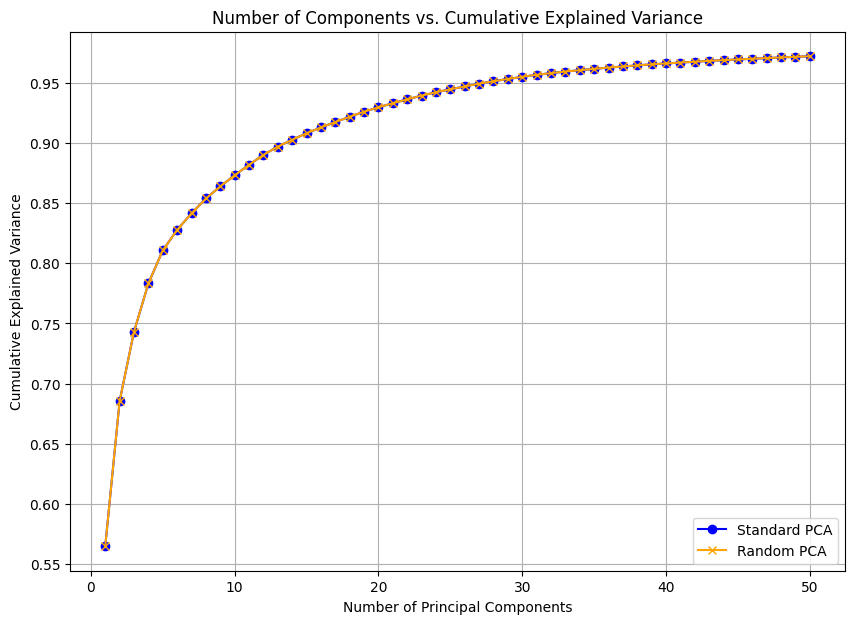

In [46]:
plt.figure(figsize=(10, 7))

# Plotting the Standard PCA
plt.plot(range(1, n_components + 1), np.cumsum(explained_variance_ratio), marker='o', label='Standard PCA', color='blue')

# Plotting the Random PCA
plt.plot(range(1, n_components + 1), np.cumsum(random_explained_variance_ratio), marker='x', label='Random PCA', color='orange')

# Setting up the title, labels, and legend
plt.title('Number of Components vs. Cumulative Explained Variance')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

These look extremely similar (if not exactly the same). I will need further visualization of the difference between the two.

#### 3c2. Comparing time to calculate

In [47]:
import time

start_time = time.time()
pca.fit(np_data)
pca_time = time.time() - start_time

start_time = time.time()
random_pca.fit(np_data)
random_pca_time = time.time() - start_time

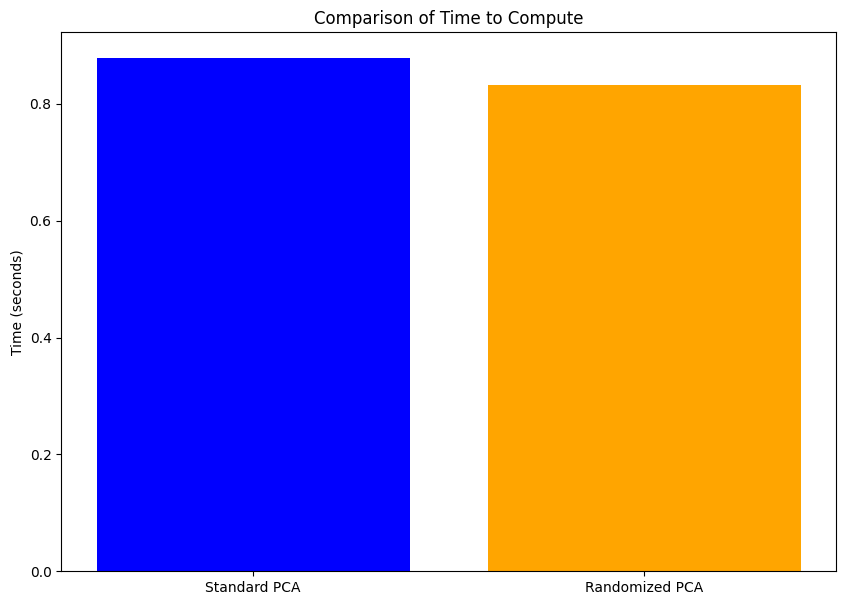

Standard PCA took 0.878 seconds to complete.
Random PCA took 0.831 seconds to complete.


In [48]:
methods = ['Standard PCA', 'Randomized PCA']
times = [pca_time, random_pca_time]

plt.figure(figsize=(10, 7))
plt.bar(methods, times, color=['blue', 'orange'])
plt.title('Comparison of Time to Compute')
plt.ylabel('Time (seconds)')
plt.show()

print(f"Standard PCA took {pca_time:.3f} seconds to complete.")
print(f"Random PCA took {random_pca_time:.3f} seconds to complete.")

The standard PCA was only slightly slower than the randomized PCA. Because randomized PCA is supposed to be computational less burdensome to process, it was expected that it would be faster. However, this difference of just ~0.035 seconds is not significant.

#### 3c3. Reconstruction Error Comparison

In [50]:
from sklearn.metrics import mean_squared_error

reconstructed_pca = pca.inverse_transform(principal_componenents)
reconstructed_random_pca = random_pca.inverse_transform(random_principal_componenents)

error_pca = mean_squared_error(scaled_data, reconstructed_pca)
error_random_pca = mean_squared_error(scaled_data, reconstructed_random_pca)

print("Reconstruction Error for Standard PCA: ", error_pca)
print("Reconstruction Error for Random PCA:   ", error_random_pca)

Reconstruction Error for Standard PCA:  0.5524589409336016
Reconstruction Error for Random PCA:    0.5524432144986344


Again, the difference here between the two is not significant. What this tells me is that when the data is reconstructed (inversely transformed from the principal components), both standard and randomized PCA are performing basically the same at preserving the characteristics of the original data.

#### 3c4. Standard vs. Randomized PCA Conclusions
From the above two comparisons, I cannot conclude which tool is better suited for this task.

However, one issue with my data might account for the sameness of performance by both standard and randomized PCA:
- Because every image in the dataset (for both classes) only has a small amount of the total pixel space used by the actual animal in the image, a large majority of every image contains the same forrested foliage "noise." This means that when my images are linearized, PCA and random PCA would be operating off of this noise, with only a small percentage of the line of pixels being the actual animal. This problem is compounded by the fact that deer and hogs look awfully similar in a grainy trail camera image, especially when the head of the animal is obscured. Additionally, because the original images were taken in the same locations (physical spot each camera was set up), images of both deer and hogs may contain the exact same foliage background for a large number of the images. In essence, the images of the dataset are not different enough from eachother to provide meaningful distinction when applying standard and random PCA. I assume now that this will also be a problem with any future model I train on this dataset.

### 3d. Feature extraction using DAISY

In [62]:
from skimage.feature import daisy

In [83]:
features = []

In [84]:
height, width = 120, 120

number_images = len(np_data)

In [85]:
for i in range(number_images):
    image_reshape = np_data[i].reshape(height, width)
    
    daisies = daisy(
        image_reshape,
        step=30,
        radius=30,
        rings=2,
        histograms=8,
        orientations=8
    )
    
    flat_daisies = daisies.reshape(-1)
    
    features.append(flat_daisies)

features = np.array(features)

In [86]:
print(features); print(len(features)); print(len(features[0]))

[[0.0074629  0.00704103 0.00491883 ... 0.00883877 0.00628861 0.00596339]
 [0.00756854 0.00719936 0.00501787 ... 0.00882002 0.00619488 0.00592918]
 [0.00763866 0.00728567 0.00504047 ... 0.00882079 0.00620069 0.00595554]
 ...
 [0.00515419 0.00644283 0.00515223 ... 0.00509717 0.00422315 0.00340598]
 [0.00516694 0.00631717 0.00479556 ... 0.0049774  0.00402826 0.00334353]
 [0.00549124 0.00670111 0.00512781 ... 0.00476822 0.00391093 0.0032266 ]]
1100
544


From this it appears that for each of my 1,100 images, I now have 544 DAISY features.

Now let's see how this changes when I change the parameters of DAISY.

In [79]:
features_2 = []

In [80]:
for i in range(number_images):
    image_reshape = np_data[i].reshape(height, width)
    
    daisies = daisy(
        image_reshape,
        step=10,
        radius=10,
        rings=1,
        histograms=6,
        orientations=6
    )
    
    flat_daisies = daisies.reshape(-1)
    
    features_2.append(flat_daisies)

features_2 = np.array(features_2)

In [81]:
print(features_2); print(len(features_2)); print(len(features_2[0]))

[[0.0202998  0.02211969 0.01544323 ... 0.02042199 0.0248602  0.01772786]
 [0.02022238 0.02098795 0.01526296 ... 0.02034797 0.02490899 0.01782715]
 [0.02006437 0.02090253 0.01511148 ... 0.02015199 0.02484681 0.01753089]
 ...
 [0.01352061 0.01783349 0.01204634 ... 0.02426109 0.03025187 0.02623479]
 [0.01360869 0.01729186 0.01202087 ... 0.02515108 0.02946904 0.02758326]
 [0.01345019 0.01773794 0.01185285 ... 0.02379927 0.02808645 0.02596445]]
1100
4200


As I changed the DAISY parameters towards the lower range, I notice I now have a much larger number of features (4,200).

Let's try a higher range for parameters.

In [90]:
features_3 = []

In [91]:
for i in range(number_images):
    image_reshape = np_data[i].reshape(height, width)
    
    daisies = daisy(
        image_reshape,
        step=60,
        radius=58,
        rings=3,
        histograms=8,
        orientations=8
    )
    
    flat_daisies = daisies.reshape(-1)
    
    features_3.append(flat_daisies)

features_3 = np.array(features_3)

In [92]:
print(features_3); print(len(features_3)); print(len(features_3[0]))

[[0.00506555 0.00545555 0.00390608 ... 0.00712291 0.00639895 0.00528277]
 [0.0052496  0.00564461 0.00388386 ... 0.00713529 0.00641151 0.00528548]
 [0.00513428 0.00555583 0.00397359 ... 0.0071624  0.00645964 0.00532845]
 ...
 [0.00514868 0.00591906 0.00385543 ... 0.004263   0.00361048 0.00290003]
 [0.00525944 0.00617623 0.00390506 ... 0.00430752 0.00357486 0.00290752]
 [0.00534577 0.00637842 0.00405935 ... 0.00418776 0.00353367 0.00286052]]
1100
200


Here we now have the lowest number of features (200).

### 3e. Does DAISY show promise for my classification task?

***ChatGPT Citation***
Because I am not terribly familiar with visualizing heatmaps, and have not yet done a pairwise difference heat map, I turn to ChatGPT-4 for help understanding both how to do this, and how to interpret the results in relation to DAISY.

***Source:***
Please see my conversation with ChatGPT-4 here: [OpenAI's ChatGPT-4; accessed on 26 September 2023](https://chat.openai.com/share/7bfaaee9-34c3-48f0-b74a-1d6c690a8073)

In [148]:
from sklearn.metrics import pairwise_distances
import pandas as pd
import seaborn as sns

#### 3e1. "Medium Features" heatmap
The first parameter iteration of DAISY feature extraction ("medium" parameters) is visualized below

In [160]:
print(features)

[[0.0074629  0.00704103 0.00491883 ... 0.00883877 0.00628861 0.00596339]
 [0.00756854 0.00719936 0.00501787 ... 0.00882002 0.00619488 0.00592918]
 [0.00763866 0.00728567 0.00504047 ... 0.00882079 0.00620069 0.00595554]
 ...
 [0.00515419 0.00644283 0.00515223 ... 0.00509717 0.00422315 0.00340598]
 [0.00516694 0.00631717 0.00479556 ... 0.0049774  0.00402826 0.00334353]
 [0.00549124 0.00670111 0.00512781 ... 0.00476822 0.00391093 0.0032266 ]]


In [161]:
labels_array = np.array(labels)

# Get the unique classes and their indices in sorted order
unique_classes, class_indices = np.unique(labels_array, return_index=True)

# Sort the indices by class
sorted_indices = np.concatenate([np.where(labels_array == uc)[0] for uc in unique_classes])

# Compute pairwise distances
pairwise_distances_matrix = pairwise_distances(features, metric='euclidean')

# Sort rows and columns based on sorted indices
sorted_distances = pairwise_distances_matrix[np.ix_(sorted_indices, sorted_indices)]

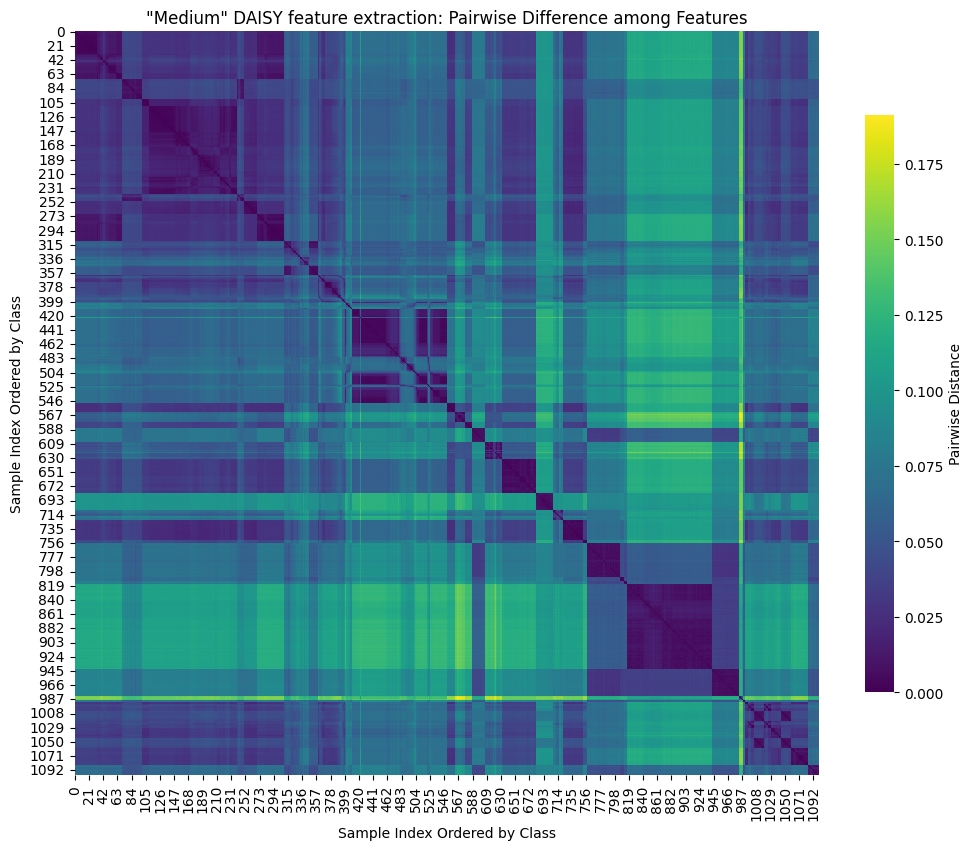

In [162]:
# Setting up the matplotlib figure
plt.figure(figsize=(12, 10))

# Drawing the heatmap with the mask and correct aspect ratio
sns.heatmap(sorted_distances, cmap='viridis', square=True, cbar_kws={"shrink": 0.75, 'label': 'Pairwise Distance'})

plt.title('"Medium" DAISY feature extraction: Pairwise Difference among Features')
plt.xlabel('Sample Index Ordered by Class')
plt.ylabel('Sample Index Ordered by Class')
plt.show()

#### 3e2. "Small Features" heatmap
The second parameter iteration of DAISY feature extraction ("small" parameters) is visualized below

In [170]:
print(features_2)

[[0.0202998  0.02211969 0.01544323 ... 0.02042199 0.0248602  0.01772786]
 [0.02022238 0.02098795 0.01526296 ... 0.02034797 0.02490899 0.01782715]
 [0.02006437 0.02090253 0.01511148 ... 0.02015199 0.02484681 0.01753089]
 ...
 [0.01352061 0.01783349 0.01204634 ... 0.02426109 0.03025187 0.02623479]
 [0.01360869 0.01729186 0.01202087 ... 0.02515108 0.02946904 0.02758326]
 [0.01345019 0.01773794 0.01185285 ... 0.02379927 0.02808645 0.02596445]]


In [171]:
labels_array = np.array(labels)

# Get the unique classes and their indices in sorted order
unique_classes, class_indices = np.unique(labels_array, return_index=True)

# Sort the indices by class
sorted_indices = np.concatenate([np.where(labels_array == uc)[0] for uc in unique_classes])

# Compute pairwise distances
pairwise_distances_matrix_2 = pairwise_distances(features_2, metric='euclidean')

# Sort rows and columns based on sorted indices
sorted_distances_2 = pairwise_distances_matrix_2[np.ix_(sorted_indices, sorted_indices)]

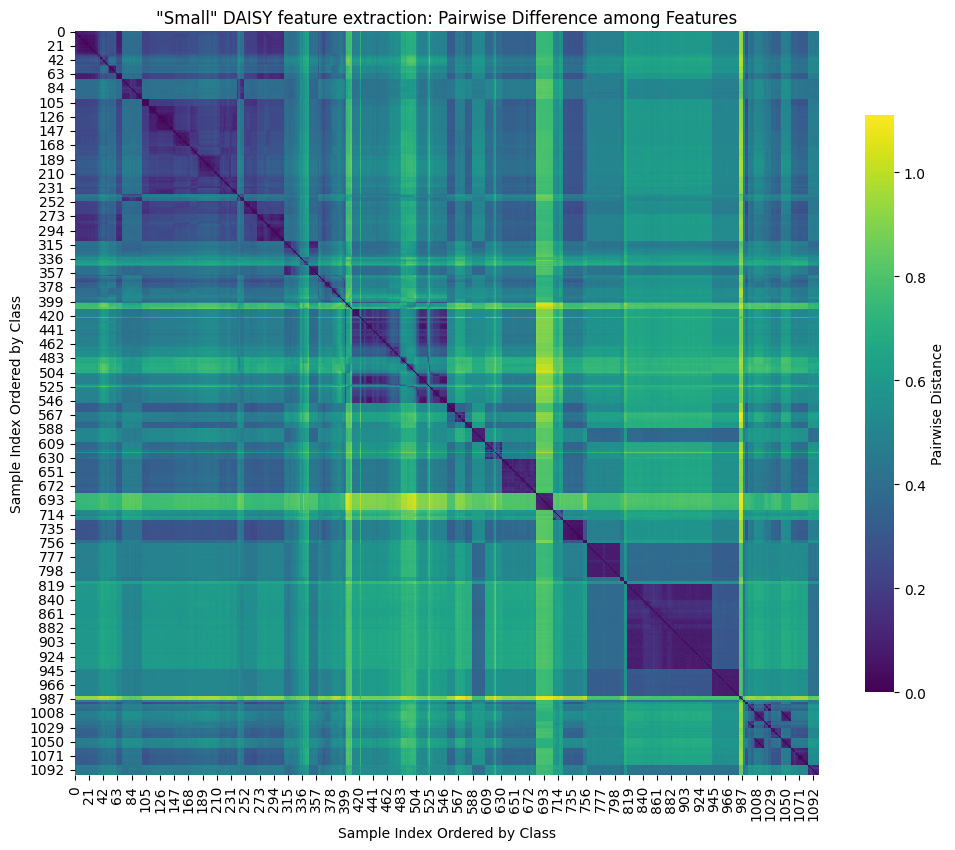

In [172]:
# Setting up the matplotlib figure
plt.figure(figsize=(12, 10))

# Drawing the heatmap with the mask and correct aspect ratio
sns.heatmap(sorted_distances_2, cmap='viridis', square=True, cbar_kws={"shrink": 0.75, 'label': 'Pairwise Distance'})

plt.title('"Small" DAISY feature extraction: Pairwise Difference among Features')
plt.xlabel('Sample Index Ordered by Class')
plt.ylabel('Sample Index Ordered by Class')
plt.show()

#### 3e3. "Large Features" heatmap
The final parameter iteration of DAISY feature extraction ("large" parameters) is visualized below

In [173]:
print(features_3)

[[0.00506555 0.00545555 0.00390608 ... 0.00712291 0.00639895 0.00528277]
 [0.0052496  0.00564461 0.00388386 ... 0.00713529 0.00641151 0.00528548]
 [0.00513428 0.00555583 0.00397359 ... 0.0071624  0.00645964 0.00532845]
 ...
 [0.00514868 0.00591906 0.00385543 ... 0.004263   0.00361048 0.00290003]
 [0.00525944 0.00617623 0.00390506 ... 0.00430752 0.00357486 0.00290752]
 [0.00534577 0.00637842 0.00405935 ... 0.00418776 0.00353367 0.00286052]]


In [174]:
labels_array = np.array(labels)

# Get the unique classes and their indices in sorted order
unique_classes, class_indices = np.unique(labels_array, return_index=True)

# Sort the indices by class
sorted_indices = np.concatenate([np.where(labels_array == uc)[0] for uc in unique_classes])

# Compute pairwise distances
pairwise_distances_matrix_3 = pairwise_distances(features_3, metric='euclidean')

# Sort rows and columns based on sorted indices
sorted_distances_3 = pairwise_distances_matrix_3[np.ix_(sorted_indices, sorted_indices)]

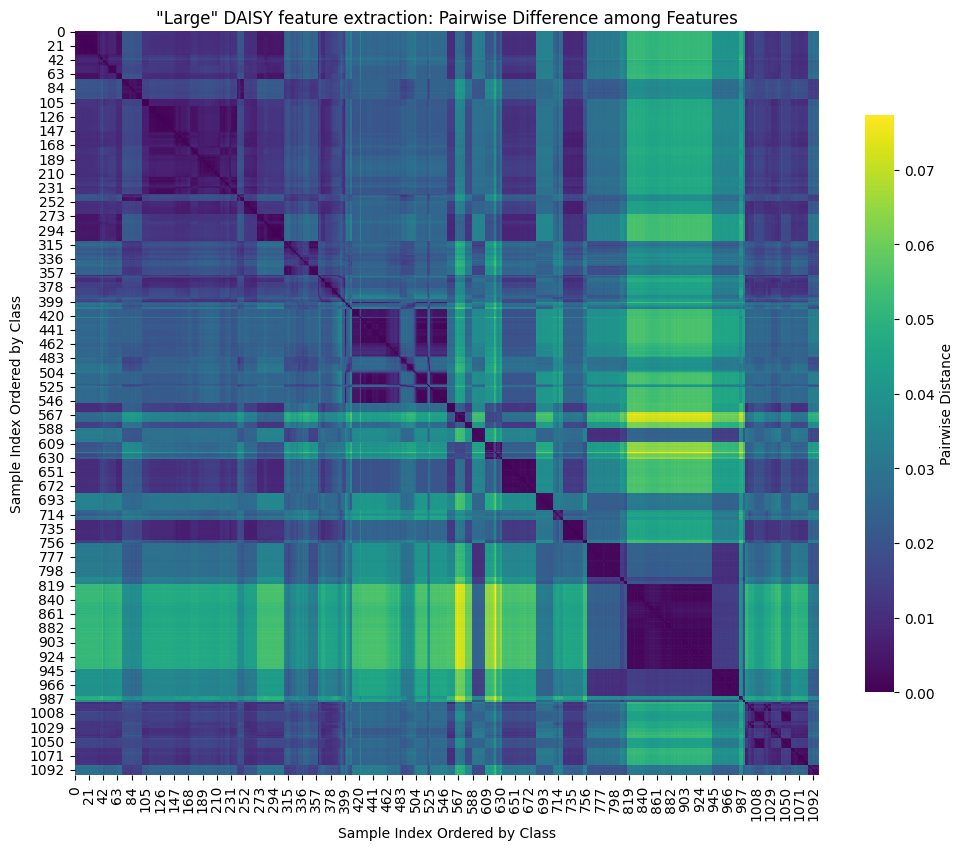

In [175]:
# Setting up the matplotlib figure
plt.figure(figsize=(12, 10))

# Drawing the heatmap with the mask and correct aspect ratio
sns.heatmap(sorted_distances_3, cmap='viridis', square=True, cbar_kws={"shrink": 0.75, 'label': 'Pairwise Distance'})

plt.title('"Large" DAISY feature extraction: Pairwise Difference among Features')
plt.xlabel('Sample Index Ordered by Class')
plt.ylabel('Sample Index Ordered by Class')
plt.show()

#### 3e4. Visualizing all three heatmaps & interpretation
Below is a visual of all three heatmaps together, for ease of visualizing

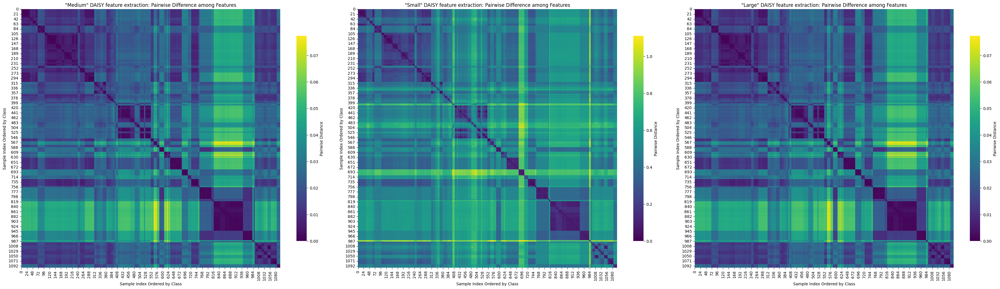

In [176]:
plt.figure(figsize=(36, 10))  # Adjusted the width to accommodate three plots side by side

# "Medium" DAISY feature extraction
plt.subplot(1, 3, 1)  # 1 row, 3 columns, index 1
sns.heatmap(sorted_distances, cmap='viridis', square=True, cbar_kws={"shrink": 0.75, 'label': 'Pairwise Distance'})
plt.title('"Medium" DAISY feature extraction: Pairwise Difference among Features')
plt.xlabel('Sample Index Ordered by Class')
plt.ylabel('Sample Index Ordered by Class')

# "Small" DAISY feature extraction
plt.subplot(1, 3, 2)  # 1 row, 3 columns, index 2
sns.heatmap(sorted_distances_2, cmap='viridis', square=True, cbar_kws={"shrink": 0.75, 'label': 'Pairwise Distance'})
plt.title('"Small" DAISY feature extraction: Pairwise Difference among Features')
plt.xlabel('Sample Index Ordered by Class')
plt.ylabel('Sample Index Ordered by Class')

# "Large" DAISY feature extraction
plt.subplot(1, 3, 3)  # 1 row, 3 columns, index 3
sns.heatmap(sorted_distances_3, cmap='viridis', square=True, cbar_kws={"shrink": 0.75, 'label': 'Pairwise Distance'})
plt.title('"Large" DAISY feature extraction: Pairwise Difference among Features')
plt.xlabel('Sample Index Ordered by Class')
plt.ylabel('Sample Index Ordered by Class')

plt.tight_layout()  # Ensure that the plots are spaced nicely
plt.show()

It seems like even with three different levels of feature extraction, this dataset has more than just 2 classes. All three heatmaps show that there are at least 3 major classes (shown by the larger dark boxes along the diagonal). There also seem to be a handful of minor classes, or at least minor groups of images that are similar, represented by the small dark boxes along the diagonal that are larger than single points.

However, one potentially positive explanation is that among the wild hog class of images, there is a marked distinction between images of adult hogs (see Figure 2 above) and litters of young hogs (Figure 3 below).

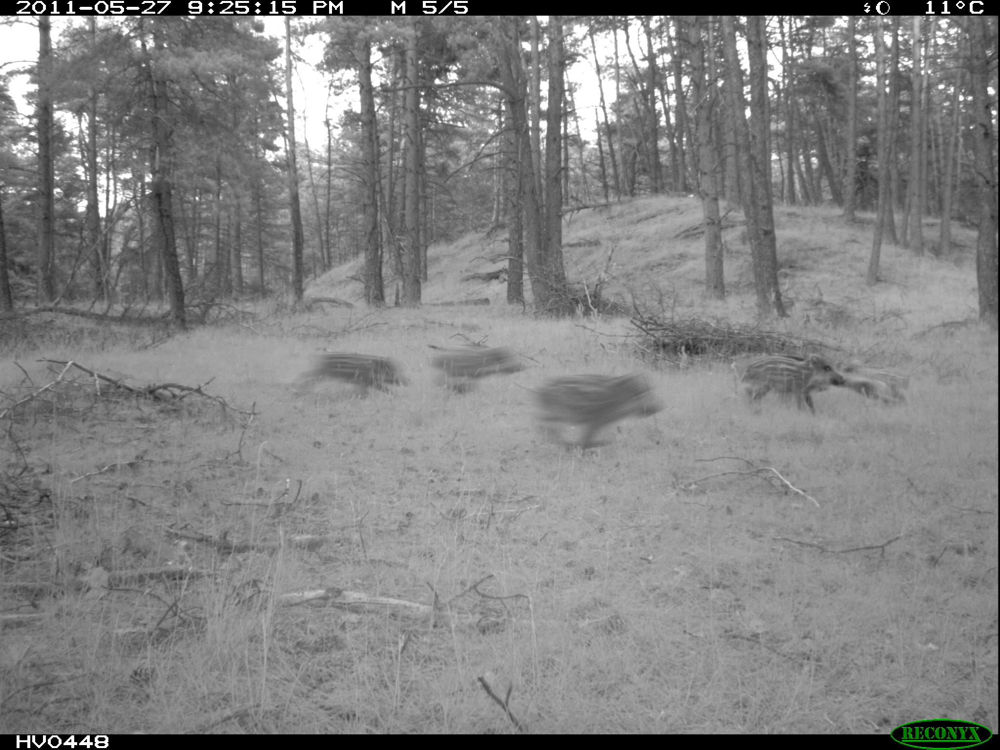

***Figure 3***

Young Wild Hog litter from the Missouri Camera Trap dataset

## 4. Additional Analysis

### 4a. Gabor Filters

***ChatGPT Citation:***
Because I have never encountered Gabor Filters before, I continue my conversation with ChatGPT-4 from earlier to understand what it is and how to implement.

***Source:***
Please see my conversation with ChatGPT-4 here: [OpenAI's ChatGPT-4; accessed on 26 September 2023](https://chat.openai.com/share/7bfaaee9-34c3-48f0-b74a-1d6c690a8073)

In [188]:
from skimage.filters import gabor

In [189]:
frequencies = [0.2, 0.4, 0.6, 0.8]
thetas = [0, np.pi/4, np.pi/2, 3*np.pi/4]

In [190]:
def apply_gabor_filter(image, frequency, theta):
    real, imag = gabor(image, frequency=frequency, theta=theta)
    return real

#### 4a1. Visualizing Deer w/ Gabor Filtering

In [202]:
image_index = 40

selected_image = data[image_index]

# Print the label for the selected image
print('Label:', labels[image_index])

Label: 1.27-White_Tailed_Deer


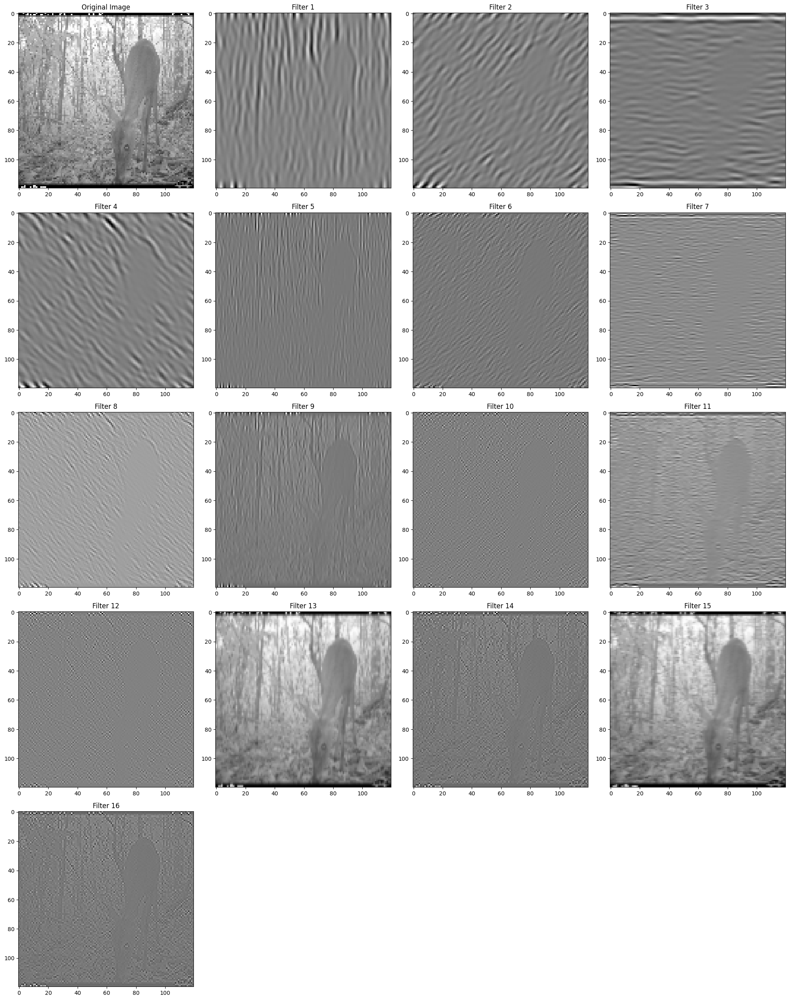

In [203]:
filtered_images = [apply_gabor_filter(selected_image, frequency, theta)
                   for frequency in frequencies
                   for theta in thetas]

# Visualize the original and Gabor filtered images
subplot_size = 5
figsize = (subplot_size * 4, subplot_size * (len(filtered_images) // 4 + 2))

plt.figure(figsize=figsize)
plt.subplot(len(filtered_images) // 4 + 2, 4, 1)
plt.title('Original Image')
plt.imshow(selected_image, cmap='gray')

for i, filtered_img in enumerate(filtered_images, start=2):
    plt.subplot(len(filtered_images) // 4 + 2, 4, i)
    plt.title(f'Filter {i-1}')
    plt.imshow(filtered_img, cmap='gray')

plt.tight_layout()
plt.show()

#### 4a2. Visualizing Hogs w/ Gabor Filtering

In [204]:
image_index = 1075

selected_image = data[image_index]

# Print the label for the selected image
print('Label:', labels[image_index])

Label: 1.59-Wild_Boar


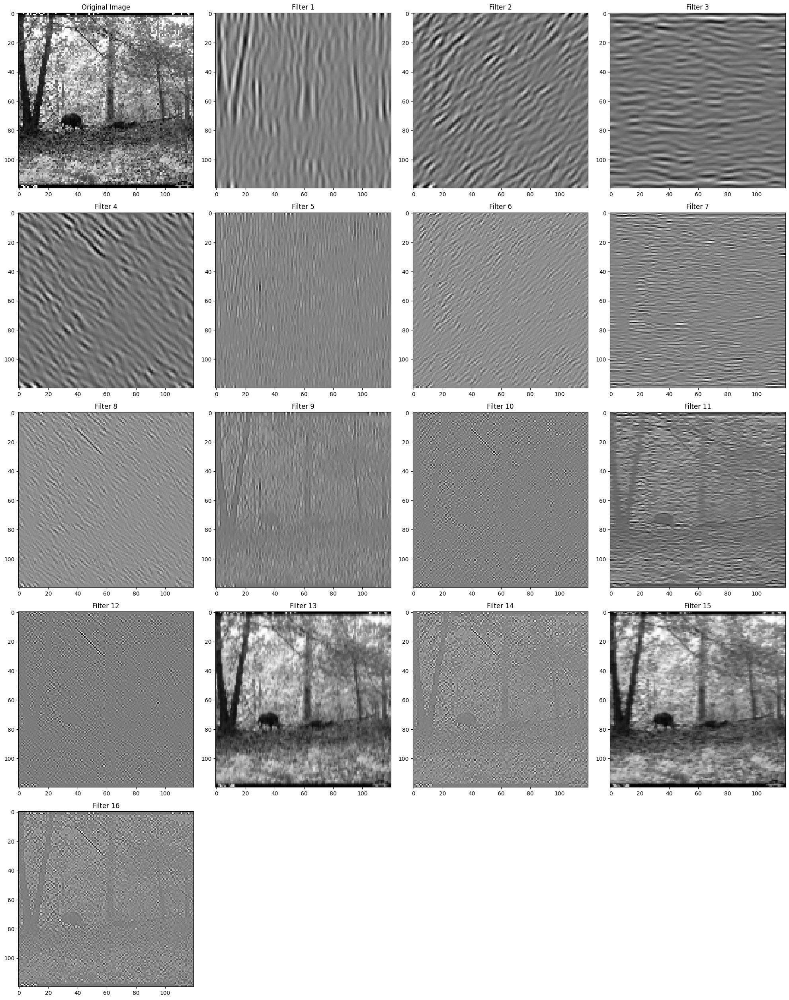

In [205]:
filtered_images = [apply_gabor_filter(selected_image, frequency, theta)
                   for frequency in frequencies
                   for theta in thetas]

# Visualize the original and Gabor filtered images
subplot_size = 5
figsize = (subplot_size * 4, subplot_size * (len(filtered_images) // 4 + 2))

plt.figure(figsize=figsize)
plt.subplot(len(filtered_images) // 4 + 2, 4, 1)
plt.title('Original Image')
plt.imshow(selected_image, cmap='gray')

for i, filtered_img in enumerate(filtered_images, start=2):
    plt.subplot(len(filtered_images) // 4 + 2, 4, i)
    plt.title(f'Filter {i-1}')
    plt.imshow(filtered_img, cmap='gray')

plt.tight_layout()
plt.show()

#### 4a3. Gabor Filtering Analysis
It seems that the Gabor filtering did a better job capturing the edge lines of the deer image above (and isolating it from the background trees) than it did for the hog. However, the hog in the image is much smaller and is closer to the background foliage, so perhaps this method is better suited for capturing information about objects (i.e., deer or hog) in an image if that object takes up more pixel space in the overall image. 

Additionally, it seems that both gabor filters picked up a lot of the background foliage "noise" and could not discriminate the animal from its environment well.

I think that this feature extraction technique does show promise for my analysis (and future classification attempts), but overall I think that my original hypothesis about the visually noisy nature of dataset images has been indicated to be correct throughout this lab. 

##### End of Report
Thank you for reading all the way to the end!